In [1]:
from sklearn.datasets import load_breast_cancer
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn import preprocessing
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

## Load dataset and concatenate

In [2]:
bc = load_breast_cancer()
breast_cancer_data = bc.data
breast_cancer_data.shape

(569, 30)

In [3]:
breast_cancer_labels = np.reshape(bc.target,(569,1)) 
breast_cancer_labels.shape

(569, 1)

In [4]:
feature_labels = np.append(bc.feature_names,'label')
feature_labels.shape

(31,)

In [5]:
breast_cancer = np.concatenate([breast_cancer_data,breast_cancer_labels],axis=1)
breast_cancer.shape

(569, 31)

### Create raw dataframe

In [6]:
breast_cancer_raw = pd.DataFrame(breast_cancer,columns=feature_labels)
breast_cancer_raw['label'].replace(0,'Benigh',inplace = True)
breast_cancer_raw['label'].replace(1,'Malignant',inplace = True)
breast_cancer_class = breast_cancer_raw.pop('label')
breast_cancer_raw.tail(5)

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400
568,7.76,24.54,47.92,181.0,0.05263,0.04362,0.00000,0.00000,0.1587,0.05884,...,9.456,30.37,59.16,268.6,0.08996,0.06444,0.0000,0.0000,0.2871,0.07039


In [7]:
 breast_cancer_class.tail(5)

564       Benigh
565       Benigh
566       Benigh
567       Benigh
568    Malignant
Name: label, dtype: object

## Data normalization and standardization

In [8]:
breast_cancer_raw_data = breast_cancer_raw.loc[:,bc.feature_names].values
breast_cancer_standard_data = StandardScaler().fit_transform(breast_cancer_raw_data)
breast_cancer_normal_data = preprocessing.normalize(breast_cancer_raw_data)
breast_cancer_normal_data.shape, np.mean(breast_cancer_normal_data), np.std(breast_cancer_normal_data)

((569, 30), 0.05702532037457236, 0.1734400362359012)

### z-score normalized dataframe

In [9]:
breast_cancer_normal = pd.DataFrame(breast_cancer_normal_data,columns=bc.feature_names)
breast_cancer_normal.tail(5)

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
564,0.008541,0.008870,0.056256,0.585933,0.000044,0.000046,0.000097,0.000055,0.000068,0.000022,...,0.010082,0.010459,0.065804,0.803033,0.000056,0.000084,0.000163,0.000088,0.000082,0.000028
565,0.009344,0.013114,0.060903,0.585355,0.000045,0.000048,0.000067,0.000045,0.000081,0.000026,...,0.010997,0.017756,0.071951,0.803528,0.000054,0.000089,0.000149,0.000076,0.000119,0.000031
566,0.011644,0.019696,0.075966,0.601905,0.000059,0.000072,0.000065,0.000037,0.000112,0.000040,...,0.013313,0.023933,0.088872,0.788417,0.000080,0.000217,0.000239,0.000099,0.000156,0.000055
567,0.009230,0.013142,0.062774,0.566806,0.000053,0.000124,0.000157,0.000068,0.000107,0.000031,...,0.011533,0.017663,0.082713,0.815932,0.000074,0.000389,0.000421,0.000119,0.000183,0.000056
568,0.023110,0.073082,0.142710,0.539032,0.000157,0.000130,0.000000,0.000000,0.000473,0.000175,...,0.028161,0.090444,0.176183,0.799912,0.000268,0.000192,0.000000,0.000000,0.000855,0.000210


### Standardized dataframe

In [10]:
breast_cancer_standard = pd.DataFrame(breast_cancer_standard_data,columns=bc.feature_names)
breast_cancer_standard.tail(5)

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst radius,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension
564,2.110995,0.721473,2.060786,2.343856,1.041842,0.219060,1.947285,2.320965,-0.312589,-0.931027,...,1.901185,0.117700,1.752563,2.015301,0.378365,-0.273318,0.664512,1.629151,-1.360158,-0.709091
565,1.704854,2.085134,1.615931,1.723842,0.102458,-0.017833,0.693043,1.263669,-0.217664,-1.058611,...,1.536720,2.047399,1.421940,1.494959,-0.691230,-0.394820,0.236573,0.733827,-0.531855,-0.973978
566,0.702284,2.045574,0.672676,0.577953,-0.840484,-0.038680,0.046588,0.105777,-0.809117,-0.895587,...,0.561361,1.374854,0.579001,0.427906,-0.809587,0.350735,0.326767,0.414069,-1.104549,-0.318409
567,1.838341,2.336457,1.982524,1.735218,1.525767,3.272144,3.296944,2.658866,2.137194,1.043695,...,1.961239,2.237926,2.303601,1.653171,1.430427,3.904848,3.197605,2.289985,1.919083,2.219635
568,-1.808401,1.221792,-1.814389,-1.347789,-3.112085,-1.150752,-1.114873,-1.261820,-0.820070,-0.561032,...,-1.410893,0.764190,-1.432735,-1.075813,-1.859019,-1.207552,-1.305831,-1.745063,-0.048138,-0.751207


### Correlation Matrix of all three dataframe

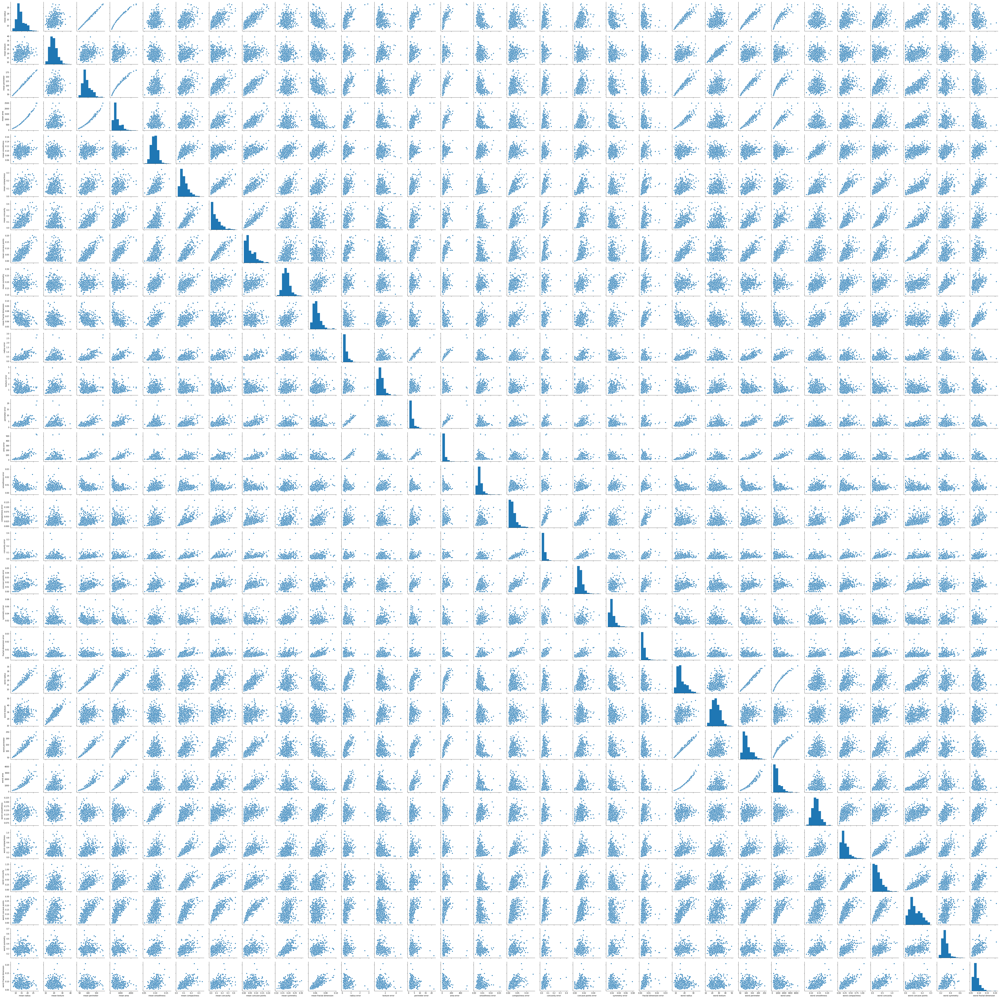

In [11]:
sns.pairplot(breast_cancer_raw)

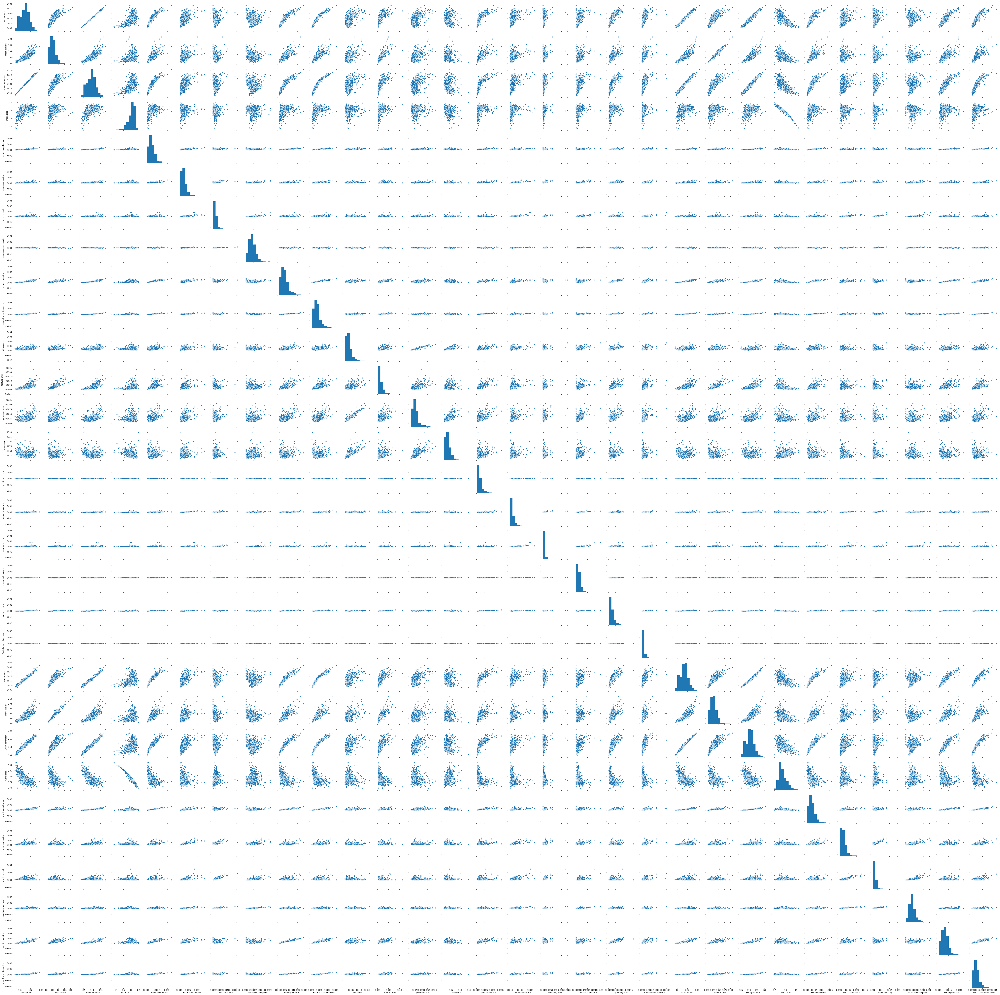

In [12]:
sns.pairplot(breast_cancer_normal)

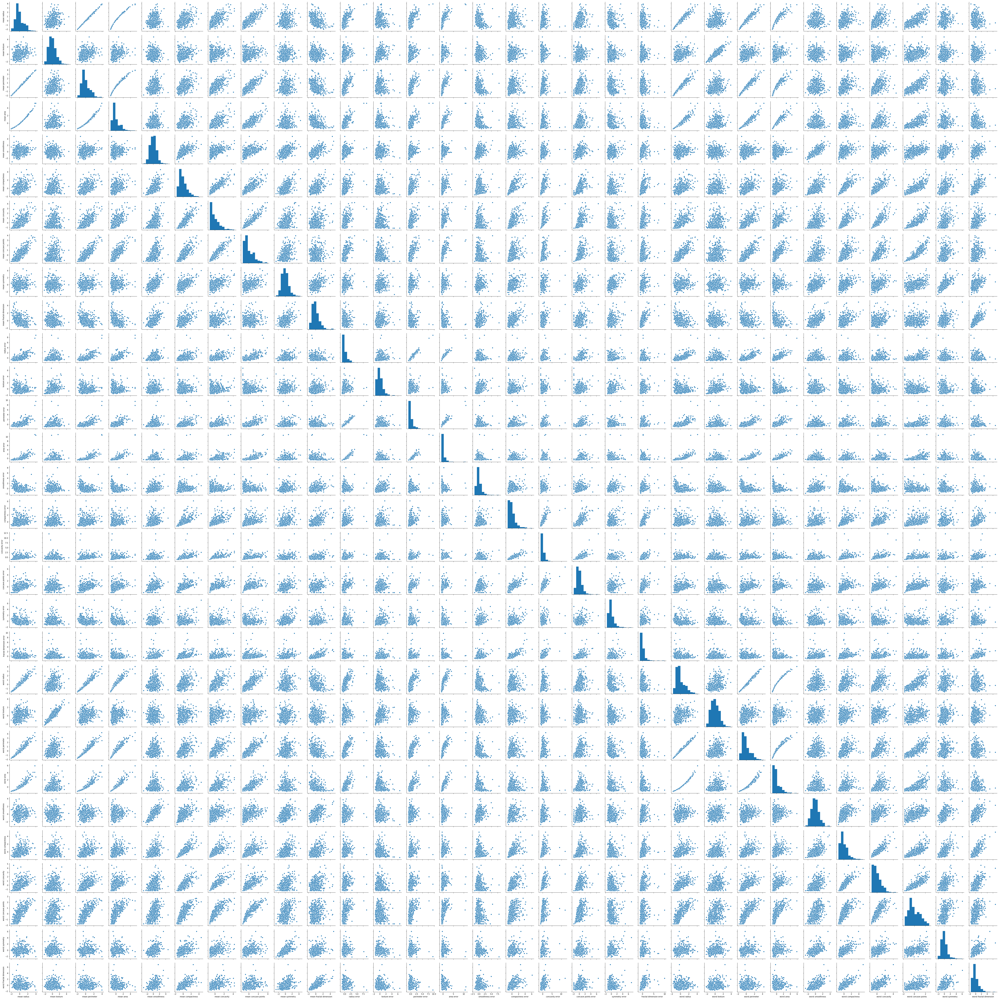

In [13]:
sns.pairplot(breast_cancer_standard)

### Apply Principle Component Analysis and Linear Discriminant Analysis  

In [14]:
pca_breast_cancer = PCA(n_components = 2)
principle_component_breast_raw = pca_breast_cancer.fit_transform(breast_cancer_raw)
principle_component_breast_normal = pca_breast_cancer.fit_transform(breast_cancer_normal)
principle_component_breast_standard = pca_breast_cancer.fit_transform(breast_cancer_standard)

In [15]:
pca_breast_cancer_raw = pd.DataFrame(data = principle_component_breast_raw, columns = ['PC1','PC2'])
pca_breast_cancer_normal = pd.DataFrame(data = principle_component_breast_normal, columns = ['PC1','PC2'])
pca_breast_cancer_standard = pd.DataFrame(data = principle_component_breast_standard, columns = ['PC1','PC2'])

<Figure size 432x288 with 0 Axes>

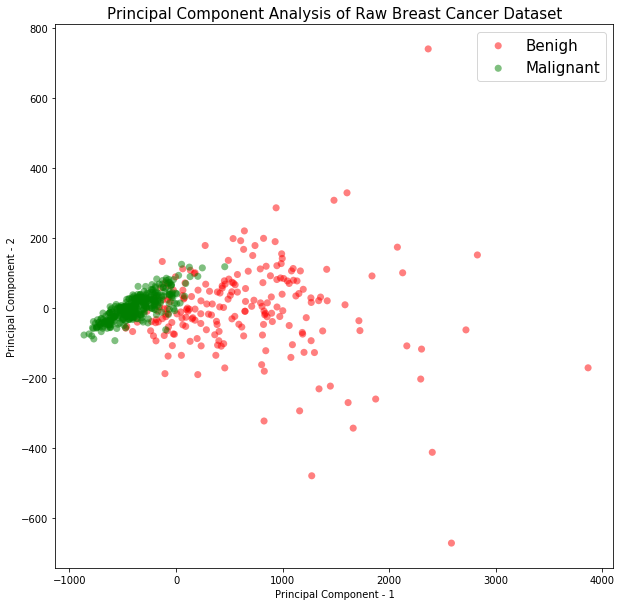

In [16]:
plt.figure()
plt.figure(figsize = (10,10))
plt.xlabel('Principal Component - 1')
plt.ylabel('Principal Component - 2')
plt.title("Principal Component Analysis of Raw Breast Cancer Dataset", fontsize = (15))
targets = ['Benigh', 'Malignant']
colors = ['r', 'g']
for target, color in zip(targets,colors):
    indicesToKeep = breast_cancer_class == target
    plt.scatter(pca_breast_cancer_raw.loc[indicesToKeep, 'PC1']
               , pca_breast_cancer_raw.loc[indicesToKeep, 'PC2'], alpha = 0.5, edgecolor = 'none', c = color, s = 50)

plt.legend(targets,prop={'size': 15})

<Figure size 432x288 with 0 Axes>

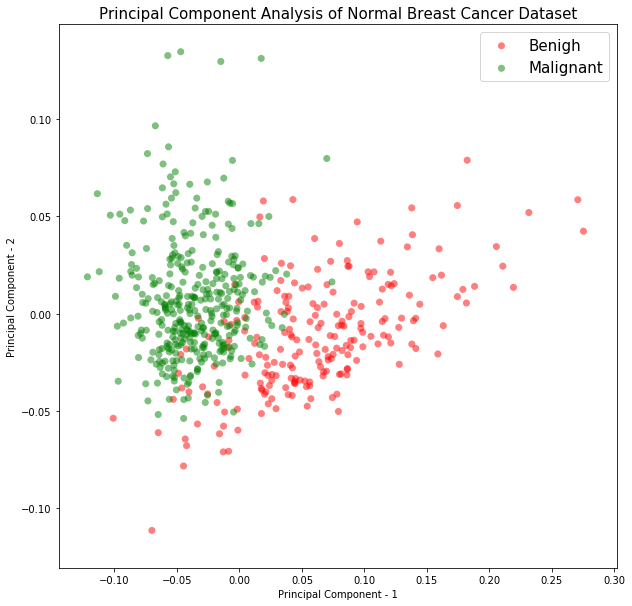

In [17]:
plt.figure()
plt.figure(figsize = (10,10))
plt.xlabel('Principal Component - 1')
plt.ylabel('Principal Component - 2')
plt.title("Principal Component Analysis of Normal Breast Cancer Dataset", fontsize = (15))
targets = ['Benigh', 'Malignant']
colors = ['r', 'g']
for target, color in zip(targets,colors):
    indicesToKeep = breast_cancer_class == target
    plt.scatter(pca_breast_cancer_normal.loc[indicesToKeep, 'PC1']
               , pca_breast_cancer_normal.loc[indicesToKeep, 'PC2'], alpha = 0.5, edgecolor = 'none', c = color, s = 50)

plt.legend(targets,prop={'size': 15})

<Figure size 432x288 with 0 Axes>

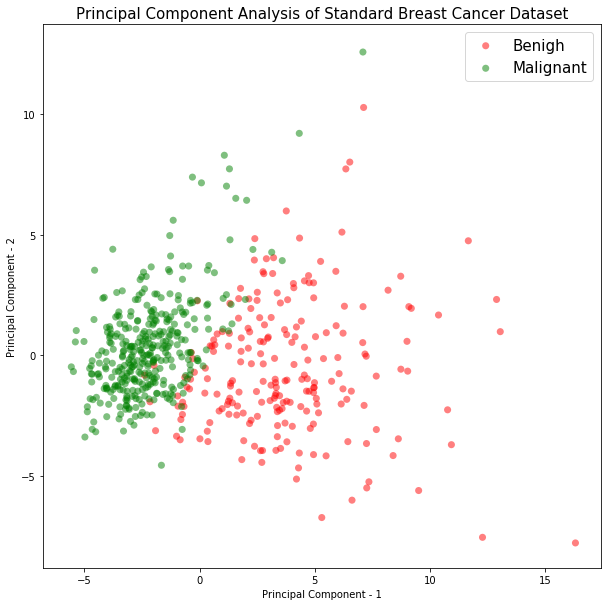

In [18]:
plt.figure()
plt.figure(figsize = (10,10))
plt.xlabel('Principal Component - 1')
plt.ylabel('Principal Component - 2')
plt.title("Principal Component Analysis of Standard Breast Cancer Dataset", fontsize = (15))
targets = ['Benigh', 'Malignant']
colors = ['r', 'g']
for target, color in zip(targets,colors):
    indicesToKeep = breast_cancer_class == target
    plt.scatter(pca_breast_cancer_standard.loc[indicesToKeep, 'PC1']
               , pca_breast_cancer_standard.loc[indicesToKeep, 'PC2'], alpha = 0.5, edgecolor = 'none', c = color, s = 50)

plt.legend(targets,prop={'size': 15})

In [19]:
ld_breast_cancer = LinearDiscriminantAnalysis()
ld_breast_cancer_raw = ld_breast_cancer.fit_transform(breast_cancer_raw.loc[:,bc.feature_names].values,breast_cancer_class)
ld_breast_cancer_normal = ld_breast_cancer.fit_transform(breast_cancer_normal.loc[:,bc.feature_names].values,breast_cancer_class)
ld_breast_cancer_standard = ld_breast_cancer.fit_transform(breast_cancer_standard.loc[:,bc.feature_names].values,breast_cancer_class)

In [20]:
LDA_breast_cancer_raw = pd.DataFrame(data = ld_breast_cancer_raw, columns = ['LD1'])
LDA_breast_cancer_normal = pd.DataFrame(data = ld_breast_cancer_normal, columns = ['LD1'])
LDA_breast_cancer_standard = pd.DataFrame(data = ld_breast_cancer_standard, columns = ['LD1'])

In [21]:
dummy_axis = np.zeros(569)
LDA_breast_cancer_raw['Y'] = dummy_axis
LDA_breast_cancer_normal['Y'] = dummy_axis
LDA_breast_cancer_standard['Y'] = dummy_axis

<Figure size 432x288 with 0 Axes>

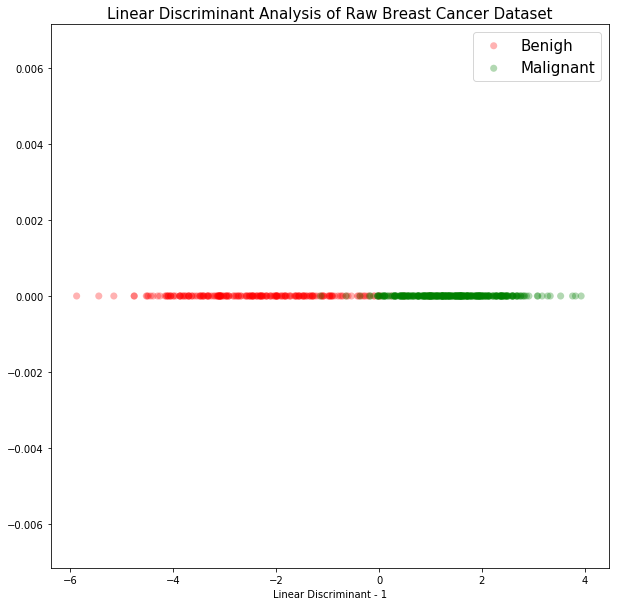

In [22]:
plt.figure()
plt.figure(figsize = (10,10))
plt.xlabel('Linear Discriminant - 1')
plt.title("Linear Discriminant Analysis of Raw Breast Cancer Dataset", fontsize = (15))
targets = ['Benigh', 'Malignant']
colors = ['r', 'g']
for target, color in zip(targets,colors):
    indicesToKeep = breast_cancer_class == target
    plt.scatter(LDA_breast_cancer_raw.loc[indicesToKeep, 'LD1']
               , LDA_breast_cancer_raw.loc[indicesToKeep, 'Y'], alpha = 0.3, edgecolor = 'none', c = color, s = 50)

plt.legend(targets,prop={'size': 15})

<Figure size 432x288 with 0 Axes>

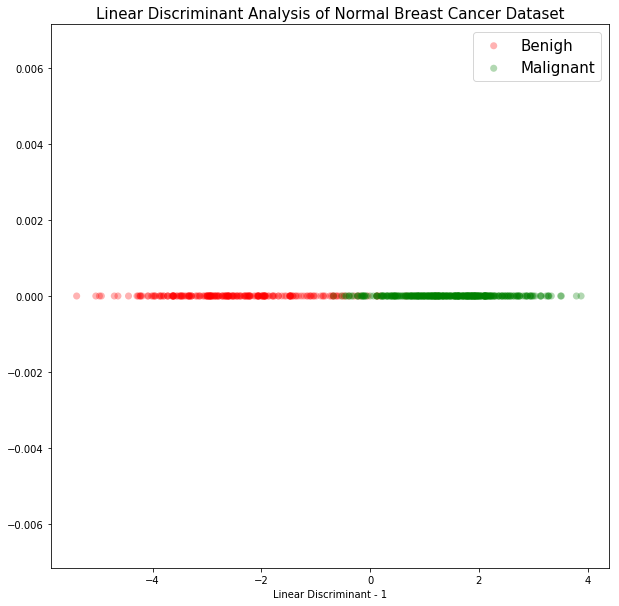

In [23]:
plt.figure()
plt.figure(figsize = (10,10))
plt.xlabel('Linear Discriminant - 1')
plt.title("Linear Discriminant Analysis of Normal Breast Cancer Dataset", fontsize = (15))
targets = ['Benigh', 'Malignant']
colors = ['r', 'g']
for target, color in zip(targets,colors):
    indicesToKeep = breast_cancer_class == target
    plt.scatter(LDA_breast_cancer_normal.loc[indicesToKeep, 'LD1']
               , LDA_breast_cancer_normal.loc[indicesToKeep, 'Y'], alpha = 0.3, edgecolor = 'none', c = color, s = 50)

plt.legend(targets,prop={'size': 15})

<Figure size 432x288 with 0 Axes>

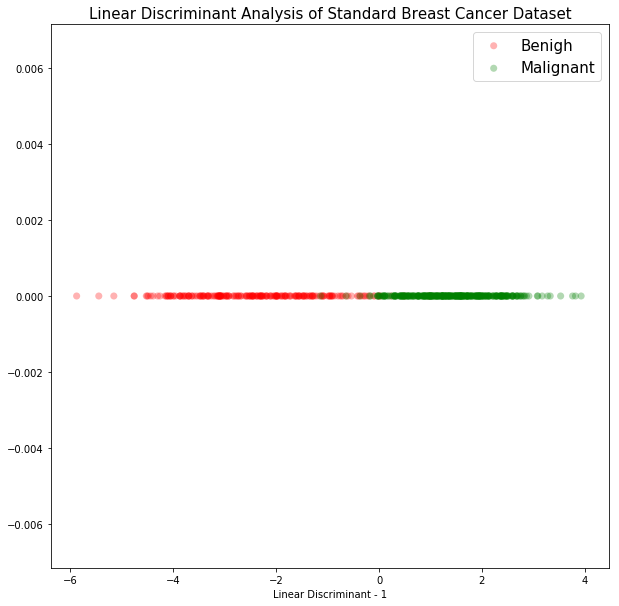

In [24]:
plt.figure()
plt.figure(figsize = (10,10))
plt.xlabel('Linear Discriminant - 1')
plt.title("Linear Discriminant Analysis of Standard Breast Cancer Dataset", fontsize = (15))
targets = ['Benigh', 'Malignant']
colors = ['r', 'g']
for target, color in zip(targets,colors):
    indicesToKeep = breast_cancer_class == target
    plt.scatter(LDA_breast_cancer_standard.loc[indicesToKeep, 'LD1']
               , LDA_breast_cancer_standard.loc[indicesToKeep, 'Y'], alpha = 0.3, edgecolor = 'none', c = color, s = 50)

plt.legend(targets,prop={'size': 15})

### Test KNN with raw dataframe, standard&pca dataframe and normal&lda dataframe

In [25]:
X_raw = np.array(breast_cancer_raw.loc[:,bc.feature_names])
X_s_pca = np.array(pca_breast_cancer_standard[['PC1','PC2']])
X_n_lda = np.array(LDA_breast_cancer_normal['LD1']).reshape(-1,1)
y = breast_cancer_class
X_train_raw,X_test_raw,y_train,y_test = train_test_split(X_raw,y,test_size=0.20,random_state=0)
X_train_s_pca,X_test_s_pca,y_train,y_test = train_test_split(X_s_pca,y,test_size=0.20,random_state=0)
X_train_n_lda,X_test_n_lda,y_train,y_test = train_test_split(X_n_lda,y,test_size=0.20,random_state=0)

In [26]:
knn_raw = KNeighborsClassifier(n_neighbors = 5, metric = 'euclidean')
knn_s_pca = KNeighborsClassifier(n_neighbors = 5, metric = 'euclidean')
knn_n_lda = KNeighborsClassifier(n_neighbors = 5, metric = 'euclidean')
knn_raw.fit(X_train_raw,y_train)
knn_s_pca.fit(X_train_s_pca,y_train)
knn_n_lda.fit(X_train_n_lda,y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='euclidean',
           metric_params=None, n_jobs=None, n_neighbors=5, p=2,
           weights='uniform')

In [27]:
print("KNN using raw dataset: %4.4f;\nKNN using standard&pca dataset: %4.4f;\nKNN using normal&lda dataset: %4.4f" %(knn_raw.score(X_train_raw,y_train),
                                                                                                                          knn_s_pca.score(X_train_s_pca,y_train),
                                                                                                                          knn_n_lda.score(X_train_n_lda,y_train)))

KNN using raw dataset: 0.9495;
KNN using standard&pca dataset: 0.9495;
KNN using normal&lda dataset: 0.9736
